Brightside Data Challenge

Hello, I'm Sean Findley-McMillon. Thanks for considering my challenge solution. Please contact me at 520-433-0041 or sgmcmillon@gmail.com.

Importing some standard libraries. os for directory manipulation. re for possible string cleaning. Pandas and Numpy to give structure and manipulate the csv.

In [1]:
import pandas as pd
import numpy as np
import os
import re

Created an EDA helper function to look up what each of the features represent. I won't show that I am using it in this notebook because it would be redundant.

In [2]:
data_dict = pd.read_excel('docs/data_dictionary.xlsx')
pd.set_option('display.max_colwidth', -1)
def col_descr(col):
    ''' 
    Takes in a column name and searchs the data_dictionary.xlsx file to produce its description.
    '''
    print(data_dict[data_dict['LoanStatNew'] == f'{col}']['Description'])

Reading in the data. Doing prelimenary data exploration. Looks like decent amount of varying data formats. Quite a few missing data points. I'm wondering if the loans aren't unique to just this csv. The other datasets could show the lifetime of the loan. 

In [3]:
df = pd.read_csv('data/2016Q1.csv.gz')
#First look at the data.
df.head()

/Users/annahernandez/opt/anaconda3/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3058: DtypeWarning: Columns (20) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


,Unnamed: 0,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,...,hardship_payoff_balance_amount,hardship_last_payment_amount,disbursement_method,debt_settlement_flag,debt_settlement_flag_date,settlement_status,settlement_date,settlement_amount,settlement_percentage,settlement_term
0,0,75910406,NaN,8400,8400,8400.0,36 months,9.75%,270.06,B,...,NaN,NaN,Cash,N,NaN,NaN,NaN,NaN,NaN,NaN
1,1,75768614,NaN,12000,12000,12000.0,36 months,7.89%,375.43,A,...,NaN,NaN,Cash,N,NaN,NaN,NaN,NaN,NaN,NaN
2,2,75650131,NaN,28000,28000,28000.0,36 months,7.39%,869.57,A,...,NaN,NaN,Cash,N,NaN,NaN,NaN,NaN,NaN,NaN
3,3,76084025,NaN,10000,10000,10000.0,36 months,13.67%,340.18,C,...,NaN,NaN,Cash,N,NaN,NaN,NaN,NaN,NaN,NaN
4,4,76003313,NaN,20000,20000,20000.0,36 months,11.99%,664.20,C,...,NaN,NaN,Cash,N,NaN,NaN,NaN,NaN,NaN,NaN


In [4]:
df.shape

(133887, 152)

In [5]:
df.describe()

,Unnamed: 0,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,installment,annual_inc,dti,delinq_2yrs,...,deferral_term,hardship_amount,hardship_length,hardship_dpd,orig_projected_additional_accrued_interest,hardship_payoff_balance_amount,hardship_last_payment_amount,settlement_amount,settlement_percentage,settlement_term
count,133887.000000,1.338870e+05,0.0,133887.000000,133887.000000,133887.000000,133887.000000,1.338870e+05,133870.000000,133887.000000,...,1192.0,1192.000000,1192.0,1192.000000,931.000000,1192.000000,1192.000000,3189.000000,3189.000000,3189.000000
mean,66943.000000,7.208895e+07,NaN,15589.394041,15589.394041,15581.984023,460.857775,8.046397e+04,19.547033,0.343476,...,3.0,146.267584,3.0,13.901007,423.585274,11114.788851,184.775260,5374.464744,47.729276,14.100659
std,38649.992083,3.056179e+06,NaN,8858.198349,8858.198349,8856.454888,261.614677,7.808478e+04,9.966931,0.908581,...,0.0,115.338468,0.0,9.690349,338.206811,6683.390778,194.782213,3729.808315,5.909065,7.268741
min,0.000000,5.612100e+04,NaN,1000.000000,1000.000000,775.000000,30.120000,0.000000e+00,-1.000000,0.000000,...,3.0,5.110000,3.0,0.000000,15.330000,475.920000,0.010000,200.000000,20.000000,0.000000
25%,33471.500000,7.010144e+07,NaN,8400.000000,8400.000000,8400.000000,265.680000,4.950000e+04,12.640000,0.000000,...,3.0,57.610000,3.0,6.000000,164.610000,5635.722500,40.015000,2435.000000,45.000000,10.000000
50%,66943.000000,7.205219e+07,NaN,14400.000000,14400.000000,14400.000000,398.520000,6.800000e+04,18.760000,0.000000,...,3.0,111.360000,3.0,15.000000,320.760000,10098.635000,120.545000,4553.860000,45.000000,14.000000
75%,100414.500000,7.452260e+07,NaN,21000.000000,21000.000000,21000.000000,613.910000,9.500800e+04,25.770000,0.000000,...,3.0,205.435000,3.0,23.000000,587.625000,15536.700000,267.107500,7375.000000,50.000000,18.000000
max,133886.000000,7.615383e+07,NaN,40000.000000,40000.000000,40000.000000,1536.950000,9.550000e+06,999.000000,22.000000,...,3.0,650.090000,3.0,32.000000,1889.970000,32348.480000,1407.860000,23895.910000,90.000000,65.000000


Reading in the rest of the csvs and concating onto the same data frame.

In [6]:
directory = os.fsencode('data')
df_lis =[]
for file in os.listdir(directory):
    filename = os.fsdecode(file)
    df = pd.read_csv('data/' + filename)
    df_lis.append(df)

df = pd.concat(df_lis)
#Deleteting list to save memory
del df_lis
df.shape

/Users/annahernandez/opt/anaconda3/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3058: DtypeWarning: Columns (20,60) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)
/Users/annahernandez/opt/anaconda3/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3058: DtypeWarning: Columns (119) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)
/Users/annahernandez/opt/anaconda3/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3058: DtypeWarning: Columns (130,131,132,135,136,137,140) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


(877986, 152)

Loan id's are unique. Too bad because state transtion probabilities of loan status could have been useful. I am now aiming to create multiple classification models that predict default, Hardship, and Settlement. All of these outcomes are potentially bad for the lender.

In [7]:
np.sum(df.duplicated(['id']))

0

Starting the cleaning process. along with loan identification columns(id, url, Unnamed: 0). Loans can be indentified using the dataframe index since they are all unique. Dropped all columns containing a missing value. I may need to go back to reintroduce some of these features if my models have a low accuracy and fill the missing values with the average, median, or impute them. I could also add another boolean feature denoting that I filled in the missing value.

In [8]:
no_nans = df.dropna(axis = 'columns')
no_nans = no_nans.drop(columns = ['Unnamed: 0', 'id', 'url'])
#Converting the string interest rates to floats
no_nans.int_rate = no_nans.int_rate.apply(lambda x: float(x[:-1]))
no_nans.shape

(877986, 74)

In [9]:
no_nans.columns

Index(['loan_amnt', 'funded_amnt', 'funded_amnt_inv', 'term', 'int_rate',
       'installment', 'grade', 'sub_grade', 'home_ownership', 'annual_inc',
       'verification_status', 'issue_d', 'loan_status', 'pymnt_plan',
       'purpose', 'addr_state', 'delinq_2yrs', 'earliest_cr_line',
       'fico_range_low', 'fico_range_high', 'open_acc', 'pub_rec', 'revol_bal',
       'total_acc', 'initial_list_status', 'out_prncp', 'out_prncp_inv',
       'total_pymnt', 'total_pymnt_inv', 'total_rec_prncp', 'total_rec_int',
       'total_rec_late_fee', 'recoveries', 'collection_recovery_fee',
       'last_pymnt_amnt', 'last_fico_range_high', 'last_fico_range_low',
       'collections_12_mths_ex_med', 'policy_code', 'application_type',
       'acc_now_delinq', 'tot_coll_amt', 'tot_cur_bal', 'total_rev_hi_lim',
       'acc_open_past_24mths', 'chargeoff_within_12_mths', 'delinq_amnt',
       'mo_sin_old_rev_tl_op', 'mo_sin_rcnt_rev_tl_op', 'mo_sin_rcnt_tl',
       'mort_acc', 'num_accts_ever_120_pd', 

Created a pandas profile report to quickly understand correlation, skew, and overall distribution of each feature.

In [10]:
from pandas_profiling import ProfileReport
# The next two lines is how I created and saved the report. The report takes some time to generate and I reran the
# notebook after creating the report.
# profile = ProfileReport(no_nans, title='Loan Profiling Report', style={'full_width':True})
# profile.to_file(output_file="report.html")

In [43]:
from IPython.display import display, HTML
display(HTML(filename='report.html'))

Number of variables,75
Number of observations,877986
Missing cells,0 (0.0%)
Duplicate rows,0 (0.0%)
Total size in memory,502.4 MiB
Average record size in memory,600.0 B
Numeric,47
Categorical,13
Boolean,3
Date,0
URL,0


Dropped highly correlated columns. Grade is better represented by sub_grade. Earliest_cr_line has high cardinality.

In [13]:
no_nans = no_nans.drop(columns = [
    'fico_range_low', 'installment', 'funded_amnt_inv', 'funded_amnt', 'out_prncp_inv', 'total_rec_prncp', 
    'total_pymnt_inv', 'tot_hi_cred_lim', 'num_sats', 'num_rev_tl_bal_gt_0', 'grade', 'earliest_cr_line'
])

Correcting skew. All skewed features will be corrected using the log plus constant of that feature except tax_liens which will be square rooted. Looking at the output below tax_liens was the only feature that didn't fair better in a log plus constant transformation.

In [14]:
print(np.sqrt(no_nans[['annual_inc', 'delinq_amnt', 'tax_liens', 'tot_coll_amt', 'total_rec_late_fee']]).skew(axis = 0))
print(np.log(no_nans[['annual_inc', 'delinq_amnt', 'tax_liens', 'tot_coll_amt', 'total_rec_late_fee']] + 1).skew(axis = 0))

annual_inc            5.716513 
delinq_amnt           43.012598
tax_liens             5.869067 
tot_coll_amt          6.373933 
total_rec_late_fee    6.672144 
dtype: float64
annual_inc           -3.505724 
delinq_amnt           17.325315
tax_liens             6.103023 
tot_coll_amt          2.012694 
total_rec_late_fee    5.149325 
dtype: float64


In [15]:
no_nans[['annual_inc', 'delinq_amnt', 'tot_coll_amt', 'total_rec_late_fee']] = np.log(no_nans[['annual_inc', 'delinq_amnt', 'tot_coll_amt', 'total_rec_late_fee']] + 1)
no_nans.tax_liens = np.sqrt(no_nans['tax_liens'])

Converting all binary categories into boolean features.

In [18]:
no_nans.term = no_nans.term.replace([' 36 months'], True)
no_nans.term = no_nans.term.replace([' 60 months'], False)
no_nans.pymnt_plan = no_nans.pymnt_plan.replace(['y'], True)
no_nans.pymnt_plan = no_nans.pymnt_plan.replace(['n'], False)
no_nans.initial_list_status = no_nans.initial_list_status.replace(['w'], True)
no_nans.initial_list_status = no_nans.initial_list_status.replace(['f'], False)
no_nans.application_type = no_nans.application_type.replace(['Individual'], True)
no_nans.application_type = no_nans.application_type.replace(['Joint App'], False)
no_nans.hardship_flag = no_nans.hardship_flag.replace(['Y'], True)
no_nans.hardship_flag = no_nans.hardship_flag.replace(['N'], False)
no_nans.disbursement_method = no_nans.disbursement_method.replace(['Cash'], True)
no_nans.disbursement_method = no_nans.disbursement_method.replace(['DirectPay'], False)
no_nans.debt_settlement_flag = no_nans.debt_settlement_flag.replace(['Y'], True)
no_nans.debt_settlement_flag = no_nans.debt_settlement_flag.replace(['N'], False)

Decided to make loan status a boolean feature as well. Clumping Charged Off and Default into one category and the rest in another. Being unfamiliar with loan vernacular I googled 'Charged Off' and found that these loans are assumed by the creditor to never be paid off which I think is akin to default. 

In [22]:
no_nans.loan_status = no_nans.loan_status.replace(['Late (31-120 days)', 'In Grace Period', 'Late (16-30 days)', 'Current', 'Fully Paid'], False)
no_nans.loan_status = no_nans.loan_status.replace(['Charged Off', 'Default'], True)

Created a fuction that will easily make dummy features and delete the original column.

In [19]:
def dummy(df, col):
    ''' 
    Takes in a Data Frame and column then creates dummy features from that column. Adds the dummy features and
    deletes the column. Returns the dataframe.
    '''
    dum = pd.get_dummies(df[f'{col}'])
    new_df = pd.concat([df, dum], axis = 1).drop(columns = [f'{col}'])
    return new_df

Creating dummy columns for the rest of the categorical columns.

In [20]:
dummy_lis = ['sub_grade', 'home_ownership', 'verification_status', 'issue_d', 'purpose', 'addr_state']
for col in dummy_lis:
    no_nans = dummy(no_nans, col)

In [21]:
no_nans.shape

(877986, 187)

Extracting the label columns for my 3 models.

In [23]:
hardship = no_nans.hardship_flag
settle = no_nans.debt_settlement_flag
default = no_nans.loan_status
no_nans = no_nans.drop(columns = ['hardship_flag', 'debt_settlement_flag', 'loan_status'])

There is a large disparity in number between the minority and majority class in each of these labels. I think there is enough in the minority class to undersample the majority class instead of oversampling the minority class. 

In [44]:
print(hardship.value_counts())
print(settle.value_counts())
print(default.value_counts())

False    877038
True     948   
Name: hardship_flag, dtype: int64
False    867536
True     10450 
Name: debt_settlement_flag, dtype: int64
False    796416
True     81570 
Name: loan_status, dtype: int64


Created a funtion that undersamples the majority class and returns the label sample(y), the data sample(X), and the indices of the sample in relation to the original data frame.

In [25]:
def under_sample(df, labels, minority_class, majority_class):
    '''
    Creates a random undersampling of the majority class based upon the number of rows in the minority class. This 
    function creates a 50/50 sample of the two classes. Returns the labels, data, and indices of the under sampling.
    Please note this only works with binary classes.
    '''
    min_amnt = len(labels[labels == minority_class])
    maj_idx = labels[labels == majority_class].index
    min_idx = labels[labels == minority_class].index
    rand_idx = np.random.choice(maj_idx, min_amnt, replace = True)
    sample_idx = np.concatenate([min_idx, rand_idx])
    under_sample = df.loc[sample_idx]
    under_labels = labels.loc[sample_idx]
    return under_sample, under_labels, sample_idx

Creating an under sampling of the data in relation to the default labels. Getting ready to create a default predictor. Created a train_test split.

In [37]:
from sklearn.model_selection import train_test_split
X, y, sample_idx = under_sample(no_nans, default, True, False)
X_train, X_test, y_train, y_test = train_test_split(X, y)

I am going to be using 3 different models in parallel to keep my options open if there is one standout preformer. The three different classifiers I will be trying are Random Forest, K nearest neighbors, and support vector classification.

In [38]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier

rfc = RandomForestClassifier(n_estimators=100)
svc = SVC()
knn = KNeighborsClassifier(n_neighbors = 5)


In [39]:
rfc.fit(X_train, y_train)
svc.fit(X_train, y_train)
knn.fit(X_train, y_train)

KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=None, n_neighbors=5, p=2,
                     weights='uniform')

In [40]:
rfc_pred = rfc.predict(X_test)
svc_pred = svc.predict(X_test)
knn_pred = knn.predict(X_test)

Absolutely fantastic. Extremely happy with these results. I thought I might have to make a hyper parameter tuning grid search since I ran with the default on all the models.

In [41]:
from sklearn.metrics import accuracy_score
print(accuracy_score(rfc_pred, y_test))
print(accuracy_score(svc_pred, y_test))
print(accuracy_score(knn_pred, y_test))

0.998424979820054
0.9906023795929886
0.9543473838258553


Random forest appears to be the winner. I always like to dive into the feature importances. Looks like credit score really is a good measure of financial solvency.

In [42]:
fi = pd.DataFrame(rfc.feature_importances_, index = X_train.columns, columns = ['importance']).sort_values('importance', ascending = False)
fi

,importance
last_fico_range_low,0.199666
last_fico_range_high,0.164739
out_prncp,0.156263
recoveries,0.137137
collection_recovery_fee,0.108236
...,...
ANY,0.000007
educational,0.000000
policy_code,0.000000
wedding,0.000000


Saving the default model.

In [47]:
import pickle
filename = 'default_model.pkl'
with open('models/' + filename, 'wb') as file:
    pickle.dump(rfc, file)

Training a model for hardship. Random Forest accuracy looks great.

In [56]:
X, y, sample_idx = under_sample(no_nans, hardship, True, False)
X_train, X_test, y_train, y_test = train_test_split(X, y)
rfc = RandomForestClassifier(n_estimators=100)
svc = SVC()
knn = KNeighborsClassifier(n_neighbors = 5)
rfc.fit(X_train, y_train)
svc.fit(X_train, y_train)
knn.fit(X_train, y_train)
rfc_pred = rfc.predict(X_test)
svc_pred = svc.predict(X_test)
knn_pred = knn.predict(X_test)
print(f'Random forest accuracy is {accuracy_score(rfc_pred, y_test)}')
print(f'SVC accuracy is {accuracy_score(svc_pred, y_test)}')
print(f'KNN accuracy is {accuracy_score(knn_pred, y_test)}')

Random forest accuracy is 0.9805688538439876
SVC accuracy is 0.9293156857223317
KNN accuracy is 0.925091523514503


Looks like Payment Plan is the most important feature. Does being on a payment plan mean that someone is going through hardship? I would assume so. This model could be 'cheating'. I would much rather have a model that could predict hardship before someone gets on a payment plan.

In [57]:
fi = pd.DataFrame(rfc.feature_importances_, index = X_train.columns, columns = ['importance']).sort_values('importance', ascending = False)
fi

,importance
pymnt_plan,0.316170
last_pymnt_amnt,0.086423
total_rec_late_fee,0.055613
out_prncp,0.052995
last_fico_range_high,0.025675
...,...
NONE,0.000000
educational,0.000000
renewable_energy,0.000000
wedding,0.000000


In [58]:
filename = 'hardship_model.pkl'
with open('models/' + filename, 'wb') as file:
    pickle.dump(rfc, file)

Training a settlement model. Looking for more 'cheating'. Recoveries and collection recovery fee are certainly suspect.

In [52]:
X, y, sample_idx = under_sample(no_nans, settle, True, False)
X_train, X_test, y_train, y_test = train_test_split(X, y)
rfc = RandomForestClassifier(n_estimators=100)
svc = SVC()
knn = KNeighborsClassifier(n_neighbors = 5)
rfc.fit(X_train, y_train)
svc.fit(X_train, y_train)
knn.fit(X_train, y_train)
rfc_pred = rfc.predict(X_test)
svc_pred = svc.predict(X_test)
knn_pred = knn.predict(X_test)
print(f'Random forest accuracy is {accuracy_score(rfc_pred, y_test)}')
print(f'SVC accuracy is {accuracy_score(svc_pred, y_test)}')
print(f'KNN accuracy is {accuracy_score(knn_pred, y_test)}')

Random forest accuracy is 0.9691433834817317
SVC accuracy is 0.9257752533005834
KNN accuracy is 0.9221676389315321


In [53]:
fi = pd.DataFrame(rfc.feature_importances_, index = X_train.columns, columns = ['importance']).sort_values('importance', ascending = False)
fi

,importance
recoveries,0.138268
collection_recovery_fee,0.133094
last_fico_range_low,0.079057
last_fico_range_high,0.078572
last_pymnt_amnt,0.043384
...,...
ME,0.000022
wedding,0.000000
educational,0.000000
NONE,0.000000


In [55]:
filename = 'settle_model.pkl'
with open('models/' + filename, 'wb') as file:
    pickle.dump(rfc, file)

Dropping the above suspect columns.

In [59]:
no_nans = no_nans.drop(columns = ['recoveries', 'collection_recovery_fee', 'pymnt_plan'])

From now on I am going to run with the Random Forest Classifier because it was the best preformer. Created a Random Forest function that can undersample, train test split, train, and return a Random Forest model.

In [64]:
def random_forest_loans(df, labels):
    '''
    Takes in a dataframe and the labels then undersamples, splits, trains, and assess the accuracy of the Random Forest model.
    '''
    X, y, sample_idx = under_sample(df, labels, True, False)
    X_train, X_test, y_train, y_test = train_test_split(X, y)
    rfc = RandomForestClassifier(n_estimators=100)
    rfc.fit(X_train, y_train)
    rfc_pred = rfc.predict(X_test)
    print(f'Random forest accuracy is {accuracy_score(rfc_pred, y_test)}')
    return rfc, sample_idx

Harship model looks strong.

In [65]:
hardship_model, hardship_sample_idx = random_forest_loans(no_nans, hardship)

Random forest accuracy is 0.9555180180180181


Created two confusion matricies on the rest of the data to see if the model holds up to the rest of the data set. I looks like it certainly held it's own. Please note that the confusion matrix is based on the data left over from under sampling  meaning there are no loans in Hardship being seen.

Random forest accuracy of the population is 0.999437411444394
Confusion matrix
[[863378    486]
 [     0      0]]
Normalized confusion matrix
[[9.99437411e-01 5.62588556e-04]
 [0.00000000e+00 0.00000000e+00]]


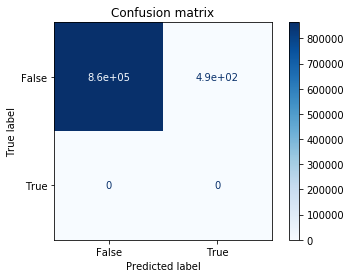

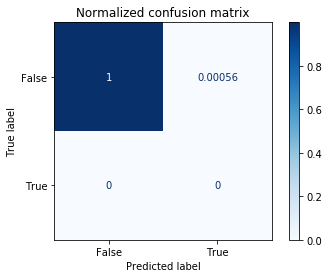

In [78]:
from sklearn.metrics import plot_confusion_matrix
import matplotlib.pyplot as plt
hard_pop_df = no_nans[~no_nans.index.isin(hardship_sample_idx)]
hard_pop_labels = hardship[~hardship.index.isin(hardship_sample_idx)]
hard_pred = hardship_model.predict(hard_pop_df)
print(f'Random forest accuracy of the population is {accuracy_score(hard_pred, hard_pop_labels)}')

titles_options = [("Confusion matrix", None),
                  ("Normalized confusion matrix", 'true')]
for title, normalize in titles_options:
    disp = plot_confusion_matrix(hardship_model, hard_pop_df, hard_pop_labels,
                                 cmap=plt.cm.Blues,
                                 normalize=normalize)
    disp.ax_.set_title(title)

    print(title)
    print(disp.confusion_matrix)

plt.show()

Saving the final hardship model.

In [80]:
filename = 'final_hardship_model.pkl'
with open('models/' + filename, 'wb') as file:
    pickle.dump(hardship_model, file)

Created a function that plots confusion matricies.

In [86]:
def confusion_matrix_pop(df, labels ,model, indices):
    '''
    Creates two confusion matricies one normalized and the other not. Also prints the accuracy score.
    '''
    pop_df = df[~df.index.isin(indices)]
    pop_labels = labels[~labels.index.isin(indices)]
    pred = model.predict(pop_df)
    print(f'Random forest accuracy of the population is {accuracy_score(pred, pop_labels)}')

    titles_options = [("Confusion matrix", None),
                      ("Normalized confusion matrix", 'true')]
    for title, normalize in titles_options:
        disp = plot_confusion_matrix(model, pop_df, pop_labels,
                                     cmap=plt.cm.Blues,
                                     normalize=normalize)
        disp.ax_.set_title(title)

        print(title)
        print(disp.confusion_matrix)

    plt.show()

Creating a new settlement and default models both have strong results. Plotted confusion matricies as well and saved the models.

In [66]:
settle_model, settle_sample_idx = random_forest_loans(no_nans, settle)

Random forest accuracy is 0.9539814387530123


Random forest accuracy of the population is 0.9884861744183829
Confusion matrix
[[725622   8452]
 [     0      0]]
Normalized confusion matrix
[[0.98848617 0.01151383]
 [0.         0.        ]]


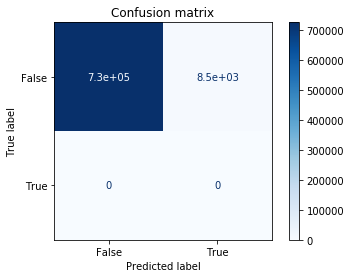

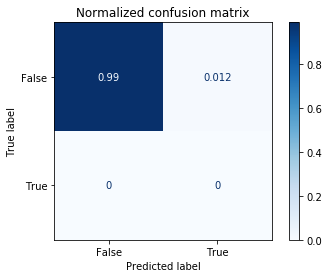

In [87]:
confusion_matrix_pop(no_nans, settle, settle_model, settle_sample_idx)

In [83]:
filename = 'final_settle_model.pkl'
with open('models/' + filename, 'wb') as file:
    pickle.dump(settle_model, file)

In [79]:
default_model, default_sample_idx = random_forest_loans(no_nans, default)

Random forest accuracy is 0.9979759674842621


Random forest accuracy of the population is 0.9980714805725774
Confusion matrix
[[207013    400]
 [     0      0]]
Normalized confusion matrix
[[0.99807148 0.00192852]
 [0.         0.        ]]


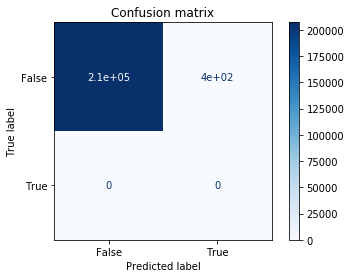

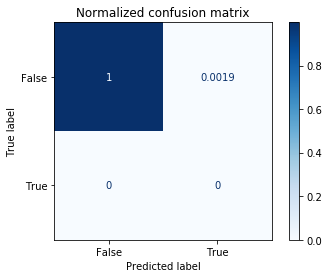

In [88]:
confusion_matrix_pop(no_nans, default, default_model, default_sample_idx)

In [89]:
filename = 'final_default_model.pkl'
with open('models/' + filename, 'wb') as file:
    pickle.dump(default_model, file)

Saving columns names to dummify new data coming in a .py file.

In [92]:
filename = 'columns.pkl'
with open(filename, 'wb') as file:
    pickle.dump(no_nans.columns, file)